# 2D animations

In [1]:
#import usual things
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
# use a function from hermite library to read in data
from hermite_library import read_hermite_solution_from_file

In [4]:
# I'll use this function to read in previously stored data
# order is:
# time, energy, position, velocity
t_h, E_h, r_h, v_h = read_hermite_solution_from_file('myPlanetSystem_kepler101_solution1.txt')

In [5]:
t_h # array in seconds

array([0.00000000e+00, 2.00040008e+03, 4.00080016e+03, ...,
       9.99599920e+06, 9.99799960e+06, 1.00000000e+07])

In [6]:
E_h # energy as a function of time, normalized units

array([-6.79919889e-05, -6.79919831e-05, -6.79919740e-05, ...,
       -6.78855546e-05, -6.78856036e-05, -6.78856481e-05])

In [10]:
r_h # position vector, [number of particles, coordinates (0,1,2)=(x,y,z), time step]

# first particle, y coord, timestep 6
r_h[0, 1, 5]

r_h.shape

(3, 3, 5000)

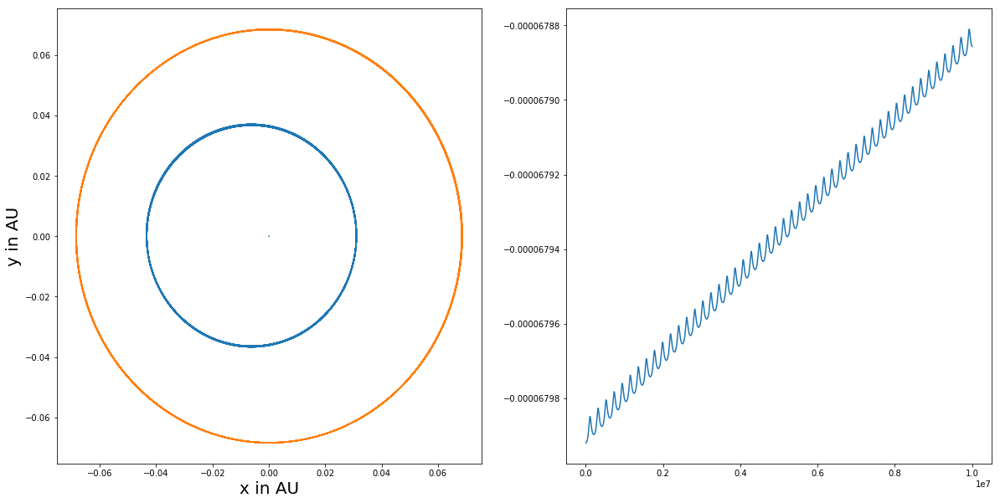

In [17]:
# let's make a quick figure

# first create a figure & axes object to store a 1x2 plot
fig, ax = plt.subplots(1, 2, figsize=(10*2, 10))

# loop over all particles and plot their x/y coordinates at all times
for i in range(r_h.shape[0]): # loop over all particles
    ax[0].plot(r_h[i, 0, :], r_h[i, 1, :])
    # above is 
    # plot(r_h[ith particle, x axis, all timesteps], r_h[ith particle, y axis, all timesteps])
    
# label the first axis
ax[0].set_xlabel('x in AU', fontsize=20) # set label on horizontal axis
ax[0].set_ylabel('y in AU', fontsize=20) # label on vertical axis
#ax[0].set_ticksize(15)

    
# also plot energy as a function of time
ax[1].plot(t_h, E_h)
# plotting time vs energy

plt.show() # show the plot!

# Lets (finally) make an animation

In [18]:
!pip install JSAnimation

In [19]:
from JSAnimation.IPython_display import display_animation # actually plot a movie in notebook
from matplotlib import animation

In [35]:
# use a stepsize for subsampling data to save on computation
stepSize = 10

In [36]:
# actually subsample our dataset
# r[number of particles, number of coordinates, number of times]
r = r_h[:,:,0:-1:stepSize]

# t and E *no* coordinates, just timesteps
t = t_h[0:-1:stepSize]
E = E_h[0:-1:stepSize]
t.shape, E_h.shape

((500,), (5000,))

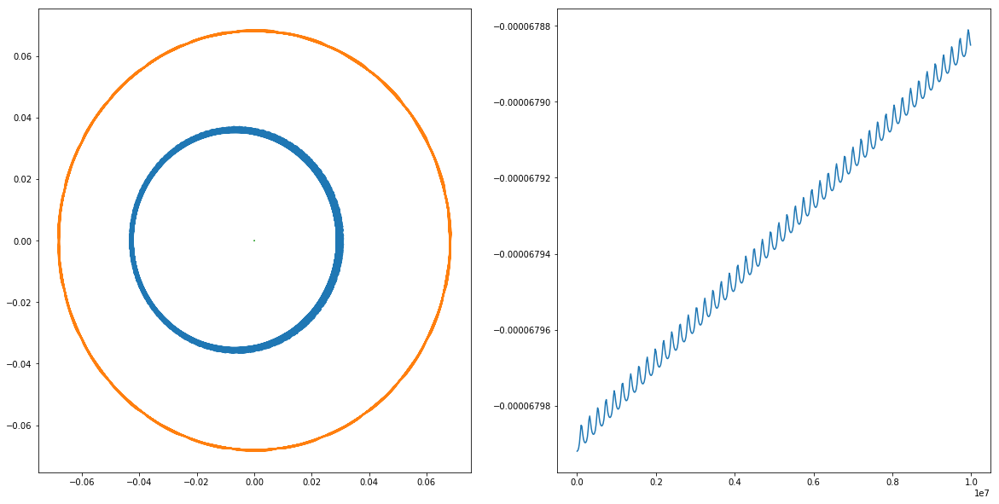

In [37]:
# we'll plot this subsampled dataset again
fig, ax = plt.subplots(1,2,figsize=(10*2,10))
# generating figure and axes for a 1x2 plot

for i in range(r.shape[0]): # loop over number of particles in subsampled position
    ax[0].plot(r[i,0,:],r[i,1,:])
    # plotting for each particle x vs y for all timesteps in subsampled position
    
# plotting subsampled energy on 2nd plot
ax[1].plot(t,E)
plt.show()

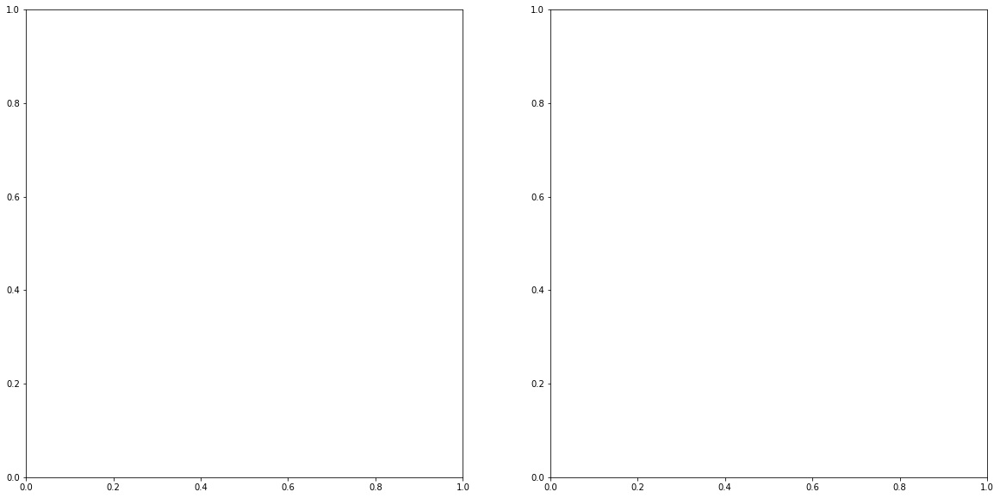

In [39]:
# first, make a figure on which to plot stuff
fig, ax = plt.subplots(1,2, figsize=(10*2,10))
# 1x2 figure

In [41]:
# import an animation function to take our positions, t, E and make animation objects
from animations_library import plot_animations

In [42]:
# use this function to generate a few objects needed for the matplotlib animation function
init, animate, nFrames = plot_animations(fig, ax, t, E, r) 


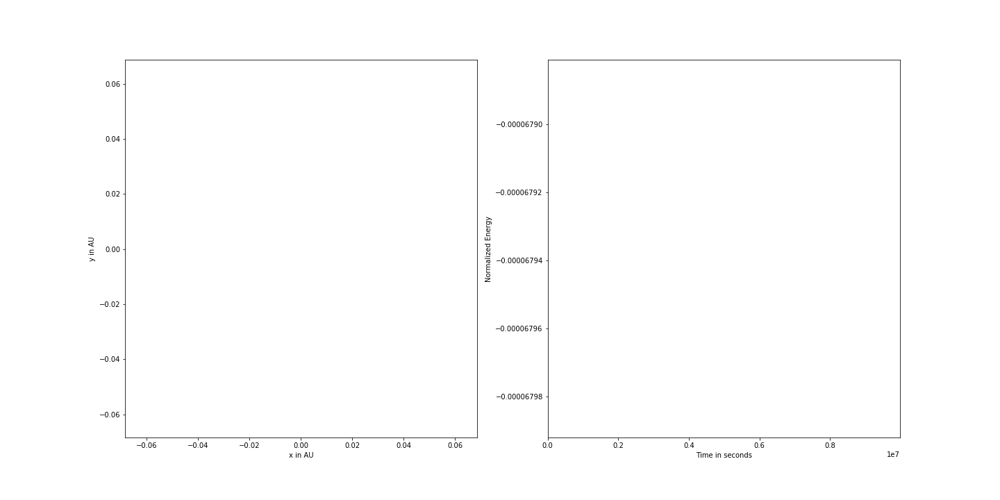
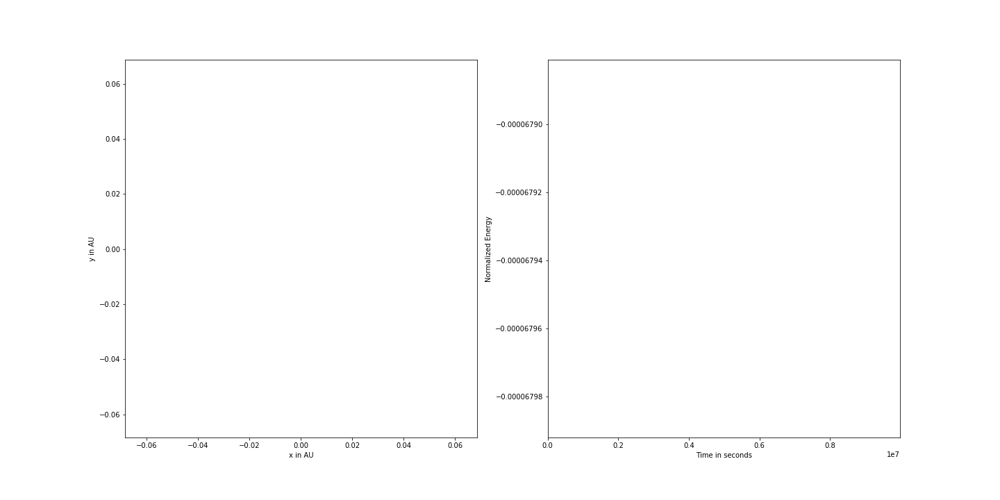
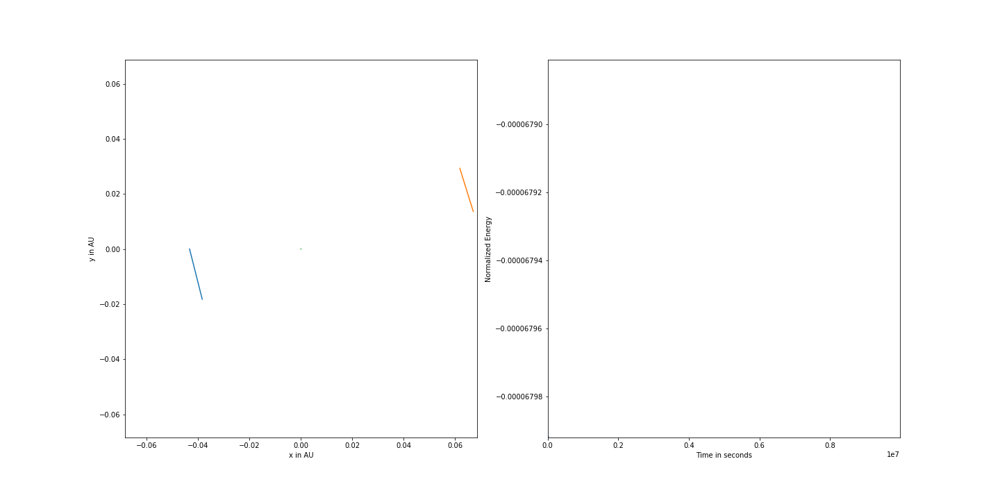
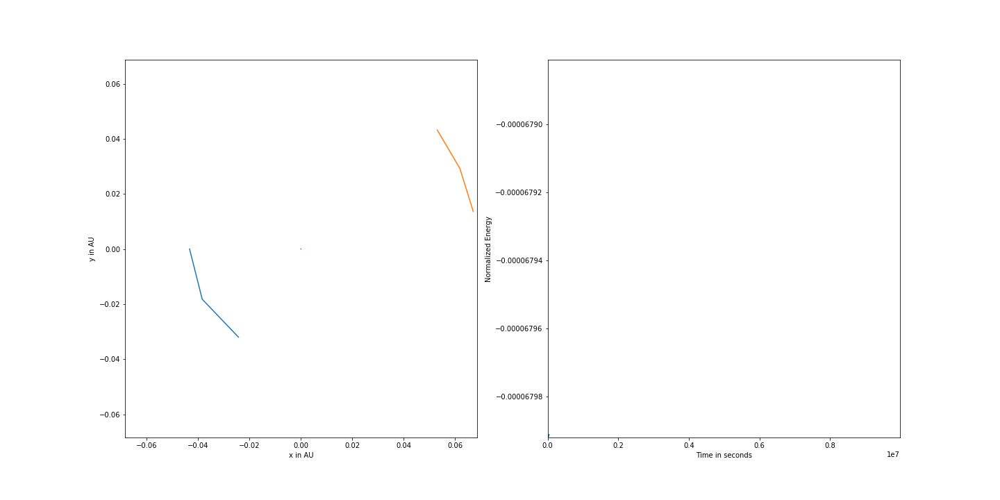
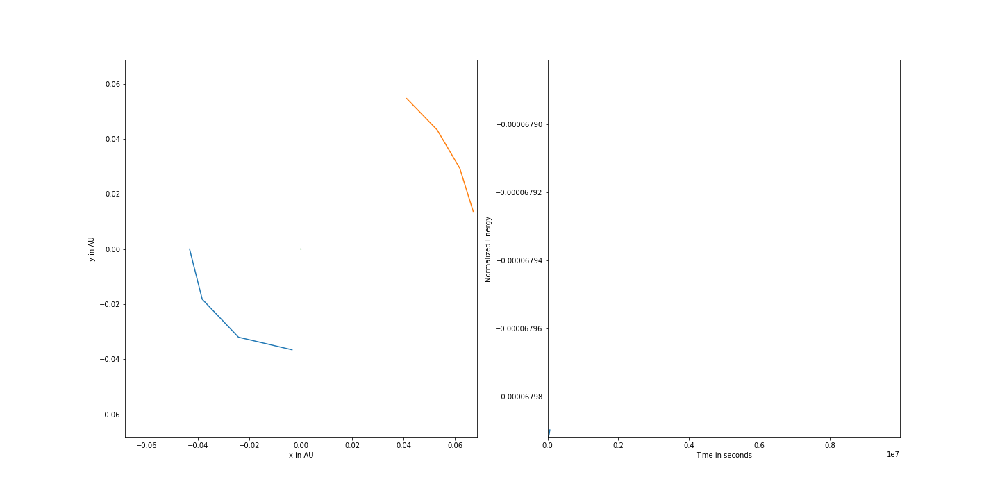
...
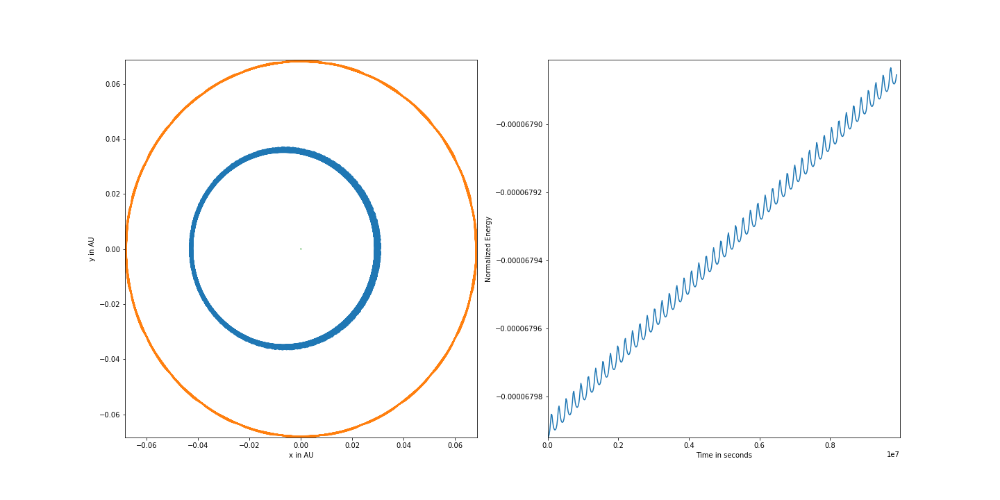
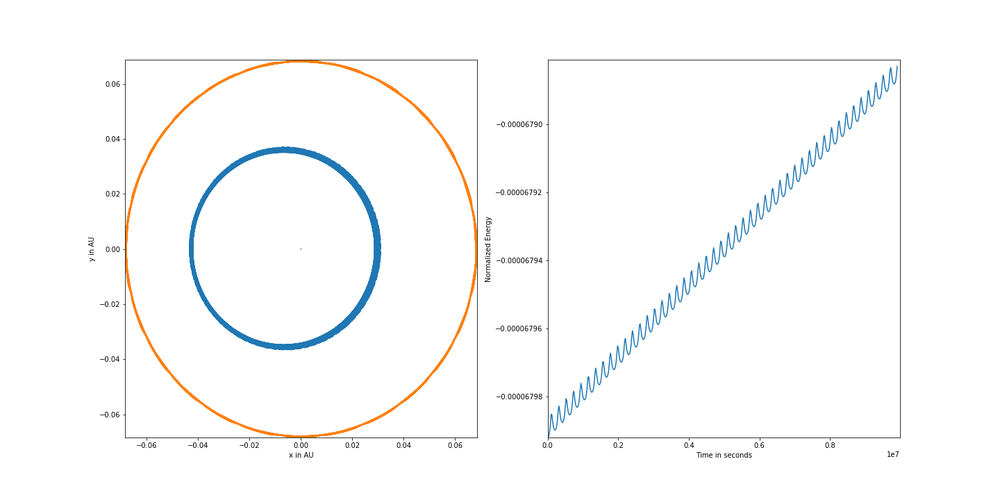
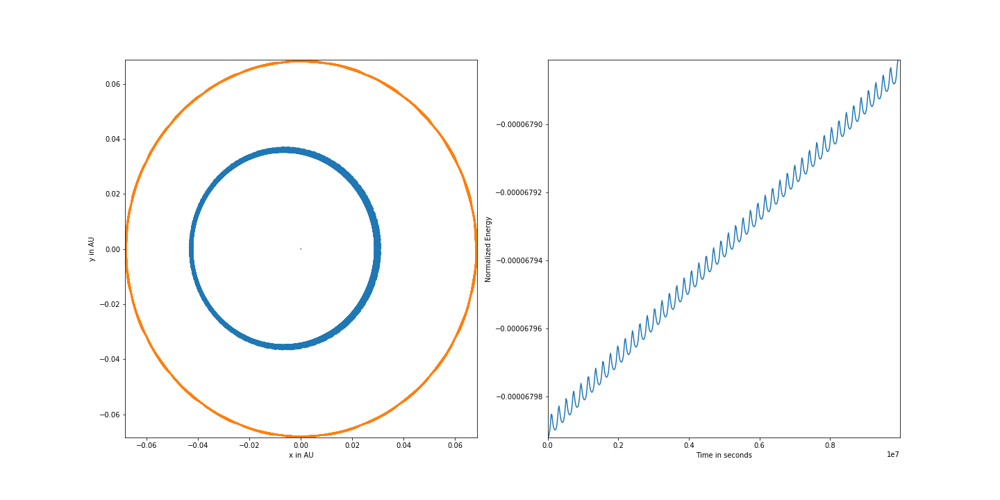
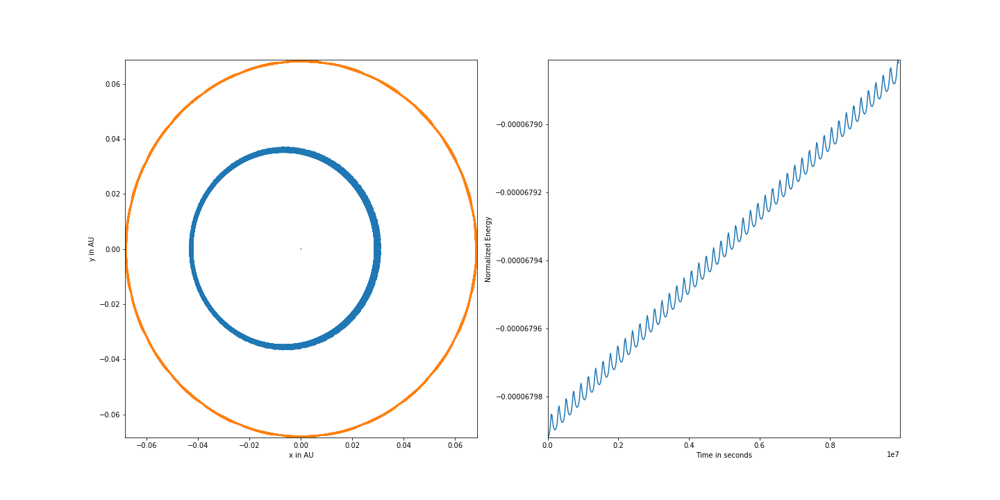
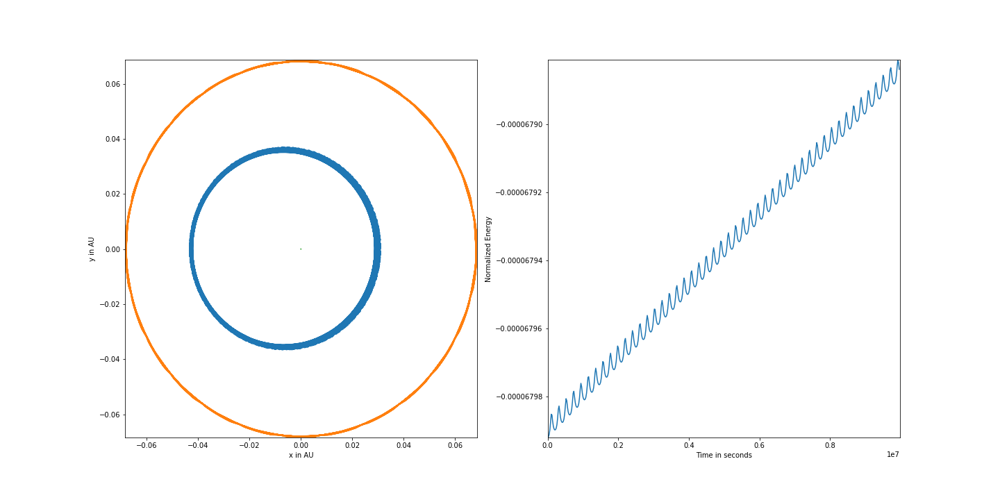

In [46]:
# use the above to make an animation & display it
anim = animation.FuncAnimation(fig, animate, init_func=init, 
                              frames = nFrames, interval=20, blit=True)
# plot on the figure object, with a function that animates
# with our initialization function, over nFrames numbers of frames
#  use an interval between frames of 20 millisec, and don't redraw everything

# finally, display this animation
display_animation(anim)

## saving animations

In [48]:
anim.save('myAnimation.gif', writer='imagemagick')

In [49]:
# for mp4 formatting
# if error along the lines of "no ffmpeg"
!conda install -c conda-forge ffmpeg --yes

Writer = animation.writers['ffmpeg'] # save with an movie writing software called ffmpeg
writer = Writer(fps=15, metadata=dict(artist='Me'), bitrate=1800) # formating for ffmpeg

In [50]:
anim.save('anim.mp4', writer=writer)